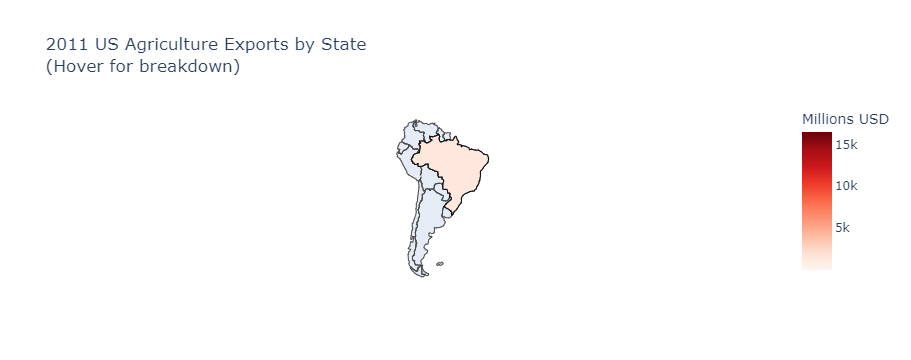

In [1]:
import plotly.graph_objects as go

import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv')

for col in df.columns:
    df[col] = df[col].astype(str)

df['text'] = df['state'] + '<br>' + \
    'Beef ' + df['beef'] + ' Dairy ' + df['dairy'] + '<br>' + \
    'Fruits ' + df['total fruits'] + ' Veggies ' + df['total veggies'] + '<br>' + \
    'Wheat ' + df['wheat'] + ' Corn ' + df['corn']

fig = go.Figure(data=go.Choropleth(
    #locations=df['code'],
    z=df['total exports'].astype(float),
    locations = ["Brazil"],
    locationmode = 'country names',
    #locationmode='USA-states',
    colorscale='Reds',
    autocolorscale=False,
    text=df['text'], # hover text
    marker_line_color='black', # line markers between states
    colorbar_title="Millions USD"
))

fig.update_layout(
    title_text='2011 US Agriculture Exports by State<br>(Hover for breakdown)',
    geo = dict(
        scope='south america',
        #projection=go.layout.geo.Projection(type = 'albers usaa'),
        showsubunits=True,
        subunitcolor="Blue",
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()



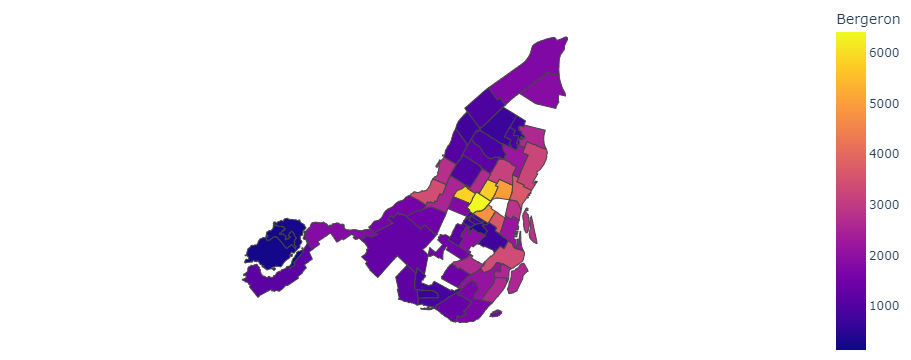

In [2]:
import plotly.express as px

df = px.data.election()
geojson = px.data.election_geojson()

fig = px.choropleth(df, geojson=geojson, color="Bergeron",
                    locations="district", featureidkey="properties.district",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

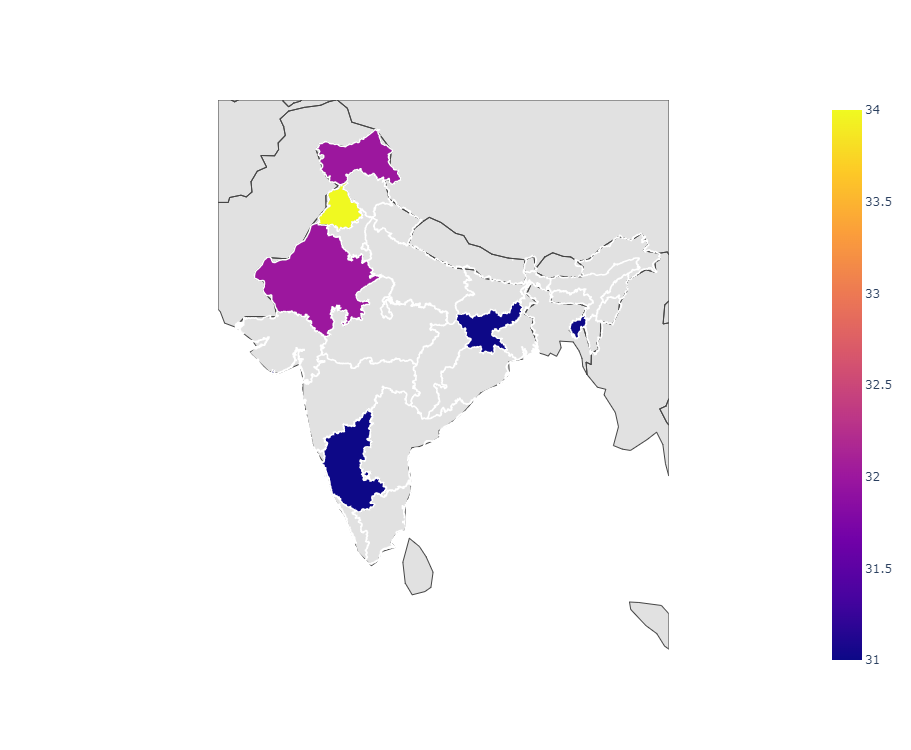

In [3]:
import plotly.express as px
import plotly.graph_objects as go
import urllib.request
import json
import pandas as pd
import numpy as np

# the body of this function I posted 2 years ago here:
# http://localhost:8888/notebooks/Documents/AAAATopojson/India-geo-Choropleth.ipynb
def state_boundaries(geojdata):
    pts = []#list of points defining boundaries of polygons, pts has as coordinates the lon and lat
    for  feature in geojdata['features']:
        if feature['geometry']['type'] == 'Polygon':
            pts.extend(feature['geometry']['coordinates'][0])    
            pts.append([None, None])#mark the end of a polygon   
        
        elif feature['geometry']['type'] == 'MultiPolygon':
            for polyg in feature['geometry']['coordinates']:
                pts.extend(polyg[0])
                pts.append([None, None])#end of polygon
        elif feature['geometry']['type'] == 'LineString': 
            points.extend(feature['geometry']['coordinates'])
            points.append([None, None])
        else: pass           
    #else: raise ValueError("geometry type irrelevant for map")
    lons, lats = zip(*pts) 
    return lons, lats

url ="https://raw.githubusercontent.com/Subhash9325/GeoJson-Data-of-Indian-States/master/Indian_States"
with urllib.request.urlopen(url) as url:
    geojson = json.loads(url.read().decode())
    #print(geojson.keys())
df = pd.DataFrame({"ids": np.arange(1, 36), "vals": np.random.randint(25,35, size=35)})
df1=df[df["vals"]>30]  #Choropleth displays only states with vals >30

lons, lats = state_boundaries(geojson)

fig= go.Figure(go.Scattergeo(lon=lons, lat=lats, mode="lines", line_width=1.5, line_color="white"))

fig.update_layout(width=700, height=750,
        geo = dict(
            scope = 'asia',
            resolution = 110,  #for info help(go.layout.Geo.resolution)
            lonaxis_range= [67, 98 ],
            lataxis_range= [2, 38],
            landcolor = 'rgb(225, 225, 225)',
        ))
#fig.show()   
#define a reduced geojson file to avoid passing non-necessary data to choropleth
reduced_geojson={"type": "FeatureCollection", "features":[]} 

for feat in geojson["features"]:
    if feat["properties"]["ID_1"] in df1["ids"]:
        reduced_geojson["features"].append(feat)
figc = px.choropleth(df1, geojson=reduced_geojson, locations='ids', 
                              color="vals", color_continuous_scale="viridis",
                              featureidkey="properties.ID_1")
#fig1.update_traces(marker_line_color="black", marker_line_width=3) #color and width of boundary color for states displayed by coropleth
fig.add_trace(figc.data[0])
fig.show()

dict_keys(['type', 'properties', 'geometry'])
{'DPA_VALOR': 0, 'DPA_ANIO': '2011', 'DPA_CANTON': '0101', 'DPA_DESCAN': 'CUENCA', 'DPA_PROVIN': '01', 'DPA_DESPRO': 'AZUAY', 'PCODE2': 'EC0101'}


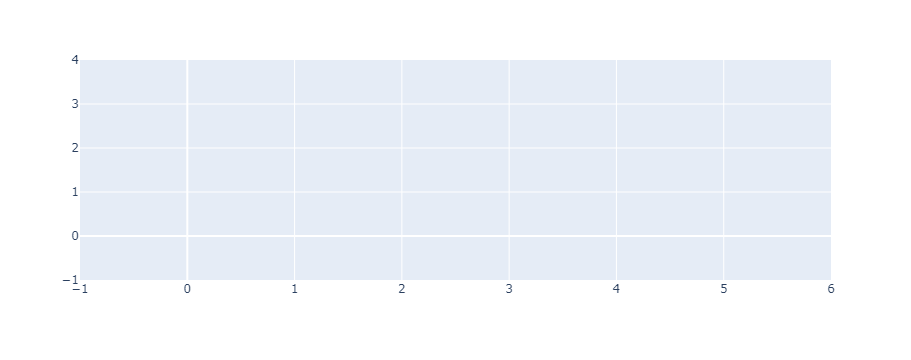

In [4]:
import plotly.express as px
import json
import geopandas as gpd
import plotly.graph_objs as go

f = open('ecu_geojson/ecuador.geojson', encoding="utf8")
data = json.load(f)

print(data['features'][0].keys())
print(data['features'][0]['properties'])

import plotly.express as px

fig = px.choropleth_mapbox(geojson=data, 
          #featureidkey='properties.id',
          #locations='canton-id',
          #color='2018',
        color_continuous_scale='algae_r',
                           zoom=6.5,
          #center={'lat': 46.8181877 , 'lon':8.2275124 },
          mapbox_style='carto-positron')

fig.update_layout(title_text='', #title,
                  title_x=0.5,
                  coloraxis_reversescale=True,
                  #coloraxis_colorscale=algae  #'Viridis',
                  );
fig.show()

In [5]:
import pandas as pd

data_url = "https://raw.githubusercontent.com/empet/Datasets/master/Swiss-synthetic-data.csv"
df = pd.read_csv(data_url)
df.head()

,canton-name,canton-id,2018,2019
0,Zürich,ZH,50,28
1,Bern/Berne,BE,56,52
2,Luzern,LU,32,35
3,Uri,UR,53,34
4,Schwyz,SZ,46,57
